## File Tree

```
Brain
|
└─── data
|   |   
|   └─── train
|   |   │
|   |   └─── 00000
|   |   │   │
|   |   │   └─── FLAIR
|   |   │   │   │ Image-1.dcm
|   |   │   │   │ Image-2.dcm
|   |   │   │   │ ...
|   |   │   │   
|   |   │   └─── T1w
|   |   │   │   │ Image-1.dcm
|   |   │   │   │ Image-2.dcm
|   |   │   │   │ ...
|   |   │   │   
|   |   │   └─── T1wCE
|   |   │   │   │ Image-1.dcm
|   |   │   │   │ Image-2.dcm
|   |   │   │   │ ...
|   |   │   │   
|   |   │   └─── T2w
|   |   │   │   │ Image-1.dcm
|   |   │   │   │ Image-2.dcm
|   |   │   │   │ ...
|   |   │ 
|   |   └─── 00001
|   |   |   | ...
|   |   |
|   |   ...
|   |
|   └─── test
|   |   | ...
|   |
|   └─── train_labels.csv
|
└─── src
|   | ...
|
└─── plt
|   | ...
|
...

## label 확인

In [1]:
import os
import pandas as pd
import pydicom
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

In [2]:
train_df = pd.read_csv('../data/train_labels.csv')
train_df

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
...,...,...
580,1005,1
581,1007,1
582,1008,1
583,1009,0


<AxesSubplot:xlabel='MGMT_value', ylabel='count'>

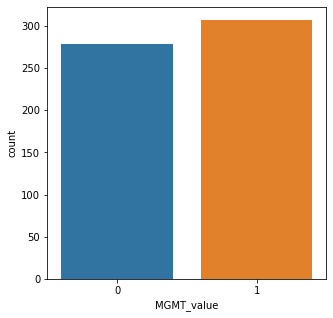

In [3]:
plt.figure(figsize=(5, 5))
sns.countplot(data=train_df, x="MGMT_value")

## 전체 환자수 확인

In [4]:
print("Train : ", len(os.listdir('../data/train/')))
print("Test : ", len(os.listdir('../data/test/')))

Train :  585
Test :  87


## 훈련 데이터의 환자, 촬영기법별 dcm파일 개수 확인

In [5]:
IN_TRAIN_PATH = '../data/train/'

def df_num_dicom_files(path):
    df = pd.DataFrame(columns=['pid', 'img_type', 'num_img'])
    # patients
    pids = []
    for pid in os.listdir(path):
        pids.append(pid)
        pid_path = os.path.join(path, pid)

        # img_types
        img_types = []
        num_imgs = 0
        for img_type in os.listdir(pid_path):
            img_types.append(img_type)
            img_path = os.path.join(pid_path, img_type)
            
            num_imgs = len(os.listdir(img_path))

            df = df.append(pd.DataFrame([[pid, img_type, num_imgs]], columns=['pid', 'img_type', 'num_img']), ignore_index=True)

    return df

df = df_num_dicom_files(IN_TRAIN_PATH)
df

,pid,img_type,num_img
0,00658,FLAIR,200
1,00658,T1wCE,184
2,00658,T1w,184
3,00658,T2w,392
4,00693,FLAIR,196
...,...,...,...
2335,00623,T2w,376
2336,00081,FLAIR,129
2337,00081,T1wCE,129
2338,00081,T1w,31


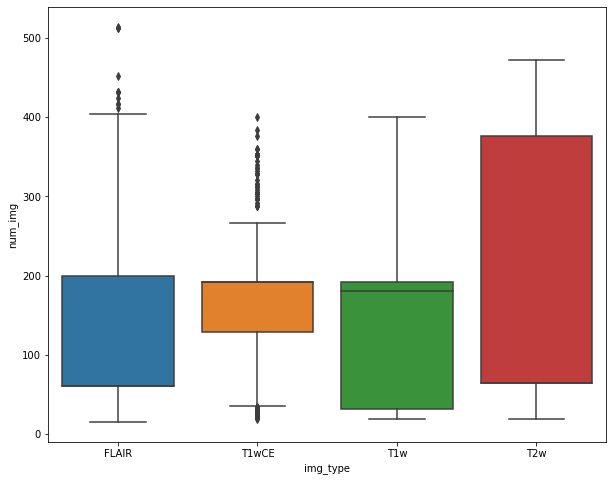

In [6]:
plt.figure(figsize=(10, 8))
sns.boxplot(data=df, x='img_type', y='num_img')
plt.show()

### 촬영 기법별 최소 dcm 파일 개수 확인

In [7]:
# 최소
df[['img_type', 'num_img']].groupby(['img_type'], as_index=False).min()

,img_type,num_img
0,FLAIR,15
1,T1w,19
2,T1wCE,19
3,T2w,19


### 촬영 기법별 최소 dcm 파일 개수를 가진 환자 번호 확인

In [8]:
# FLAIR 15 pid 확인
df[(df['img_type']=='FLAIR') & (df['num_img']==15)]

,pid,img_type,num_img
996,00818,FLAIR,15


In [9]:
# T1w 19 pid 확인
df[(df['img_type']=='T1w') & (df['num_img']==19)]

,pid,img_type,num_img
1386,00459,T1w,19


In [10]:
# T1wCE	19 pid 확인
df[(df['img_type']=='T1wCE') & (df['num_img']==19)]

,pid,img_type,num_img
1385,00459,T1wCE,19


In [11]:
# T2w 19 pid 확인
df[(df['img_type']=='T2w') & (df['num_img']==19)]

,pid,img_type,num_img
1387,00459,T2w,19


### 촬영 기법별 최대 dcm 파일 개수 확인

In [12]:
# 최대
df[['img_type', 'num_img']].groupby('img_type').max()

,num_img
img_type,
FLAIR,514
T1w,400
T1wCE,400
T2w,472


### 촬영 기법별 최대 dcm 파일 개수를 가진 환자 번호 확인

In [13]:
# FLAIR 514 pid 확인
df[(df['img_type']=='FLAIR') & (df['num_img']==514)]

,pid,img_type,num_img
1772,00563,FLAIR,514


In [14]:
# T1w 400 pid 확인
df[(df['img_type']=='T1w') & (df['num_img']==400)]

,pid,img_type,num_img
1450,00691,T1w,400


In [15]:
# T1wCE 400 pid 확인
df[(df['img_type']=='T1wCE') & (df['num_img']==400)]

,pid,img_type,num_img
1449,00691,T1wCE,400


In [16]:
# T2 472 pid 확인
df[(df['img_type']=='T2w') & (df['num_img']==472)]

,pid,img_type,num_img
207,00692,T2w,472


## 00000번 환자의 dicom 메타데이터 확인

In [17]:
import pydicom

ROOT_DIR, dicom_open = IN_TRAIN_PATH + '00000/FLAIR/', 'Image-1.dcm'

# take one sample
ds = pydicom.dcmread("{}{}".format(ROOT_DIR, dicom_open))
ds

Dataset.file_meta -------------------------------
(0002, 0010) Transfer Syntax UID                 UI: Implicit VR Little Endian
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['DERIVED', 'SECONDARY']
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.3680043.8.498.12945244209965516807097849901085909396
(0008, 0050) Accession Number                    SH: '00000'
(0008, 0060) Modality                            CS: 'MR'
(0008, 103e) Series Description                  LO: 'FLAIR'
(0010, 0010) Patient's Name                      PN: '00000'
(0010, 0020) Patient ID                          LO: '00000'
(0018, 0023) MR Acquisition Type                 CS: '3D'
(0018, 0050) Slice Thickness                     DS: '1.2'
(0018, 0081) Echo Time                           DS: None
(0018, 0082)

In [18]:
ds.Rows, ds.Columns

(512, 512)

## 훈련 데이터 해상도 종류 확인

In [19]:
IN_TRAIN_PATH = '../data/train/'

def df_dicom_img_size(path):
    df_img_size = pd.DataFrame(columns=['pid',
                                        'img_type',
                                        'num_img',
                                        'img_size',
                                        'photometric_interpretation',
                                        'magnetic_field_strength',
                                        'pixel_spacing',
                                        'image_orientation_patient',
                                        'image_position_patient'])
    # patients
    pids = []
    for pid in tqdm(os.listdir(path), desc='patients'):
        pids.append(pid)
        pid_path = os.path.join(path, pid)

        # img_types
        img_types = []
        num_imgs = 0
        for img_type in os.listdir(pid_path):
            img_types.append(img_type)
            img_path = os.path.join(pid_path, img_type)
            num_imgs = len(os.listdir(img_path))
            # img
            # with pydicom.dcmread("{}/{}".format(img_path, os.listdir(img_path)[0])) as ds:
            for img in tqdm(os.listdir(img_path), desc='images', leave=False):
                with pydicom.dcmread("{}/{}".format(img_path, img)) as ds:
                    df_img_size = df_img_size.append(pd.DataFrame([[pid,
                                                                    img_type,
                                                                    num_imgs,
                                                                    (ds.Rows, ds.Columns),
                                                                    ds.PhotometricInterpretation,
                                                                    ds.MagneticFieldStrength if 'MagneticFieldStrength' in ds else -1,
                                                                    tuple(ds.PixelSpacing),
                                                                    tuple(ds.ImageOrientationPatient),
                                                                    tuple(ds.ImagePositionPatient)]], 
                                                                    columns=['pid',
                                                                            'img_type',
                                                                            'num_img',
                                                                            'img_size',
                                                                            'photometric_interpretation',
                                                                            'magnetic_field_strength',
                                                                            'pixel_spacing',
                                                                            'image_orientation_patient',
                                                                            'image_position_patient']),
                                                        ignore_index=True)
    return df_img_size

df_2 = df_dicom_img_size(IN_TRAIN_PATH)
df_2

patients: 100%|██████████| 585/585 [2:27:27<00:00, 15.12s/it]


,pid,img_type,num_img,img_size,photometric_interpretation,magnetic_field_strength,pixel_spacing,image_orientation_patient,image_position_patient
0,00658,FLAIR,200,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(0.99877, -0.02273, 0.04406, 0.04592, 0.08904,...","(-135.21, 48.7923, 118.876)"
1,00658,FLAIR,200,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(0.99877, -0.02273, 0.04406, 0.04592, 0.08904,...","(-135.345, 41.6227, 118.228)"
2,00658,FLAIR,200,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(0.99877, -0.02273, 0.04406, 0.04592, 0.08904,...","(-138.71, -137.616, 102.032)"
3,00658,FLAIR,200,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(0.99877, -0.02273, 0.04406, 0.04592, 0.08904,...","(-139.024, -154.345, 100.521)"
4,00658,FLAIR,200,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(0.99877, -0.02273, 0.04406, 0.04592, 0.08904,...","(-138.373, -119.692, 103.652)"
...,...,...,...,...,...,...,...,...,...
348636,00081,T2w,424,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(-0.090759, 0.930507, -0.354852, 0.127458, -0....","(-87.4925, -167.269, 133.676)"
348637,00081,T2w,424,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(-0.090759, 0.930507, -0.354852, 0.127458, -0....","(-86.0109, -167.075, 133.808)"
348638,00081,T2w,424,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(-0.090759, 0.930507, -0.354852, 0.127458, -0....","(8.31278, -154.688, 142.165)"
348639,00081,T2w,424,"(512, 512)",MONOCHROME2,3.0,"(0.5, 0.5)","(-0.090759, 0.930507, -0.354852, 0.127458, -0....","(5.34974, -155.077, 141.903)"


## 해상도 확인

In [20]:
df_2['img_size'].unique()

array([(512, 512), (256, 256), (256, 192), (256, 208), (256, 224),
       (512, 448), (448, 448), (640, 640), (640, 480), (320, 260),
       (320, 280), (256, 232), (448, 406), (512, 384), (320, 250),
       (448, 336), (384, 336), (320, 290), (480, 480), (512, 416),
       (256, 216), (320, 240), (320, 256), (512, 424), (232, 256),
       (512, 464), (448, 512), (1024, 1014), (320, 320), (440, 440),
       (512, 480), (672, 672), (512, 432), (384, 348), (244, 244),
       (384, 288), (240, 240), (448, 364), (384, 312), (320, 236),
       (768, 768), (384, 320), (256, 204), (320, 272), (512, 408)],
      dtype=object)

In [21]:
df_2['img_size'].value_counts()

(512, 512)      181400
(256, 192)       69350
(256, 256)       68439
(256, 208)       10841
(512, 384)        7320
(320, 320)        1423
(256, 232)        1408
(512, 448)        1284
(512, 416)        1005
(448, 448)         966
(256, 224)         740
(320, 260)         659
(440, 440)         560
(640, 640)         374
(480, 480)         358
(244, 244)         320
(320, 280)         241
(320, 240)         166
(448, 512)         144
(512, 432)         133
(448, 406)         127
(640, 480)         120
(384, 336)         102
(320, 272)          89
(672, 672)          84
(240, 240)          75
(320, 290)          66
(384, 312)          64
(320, 250)          64
(384, 348)          64
(232, 256)          60
(256, 204)          60
(512, 464)          60
(448, 364)          59
(384, 288)          56
(320, 256)          52
(512, 480)          50
(768, 768)          50
(512, 408)          40
(320, 236)          34
(448, 336)          32
(256, 216)          28
(512, 424)          27
(384, 320) 

<AxesSubplot:>

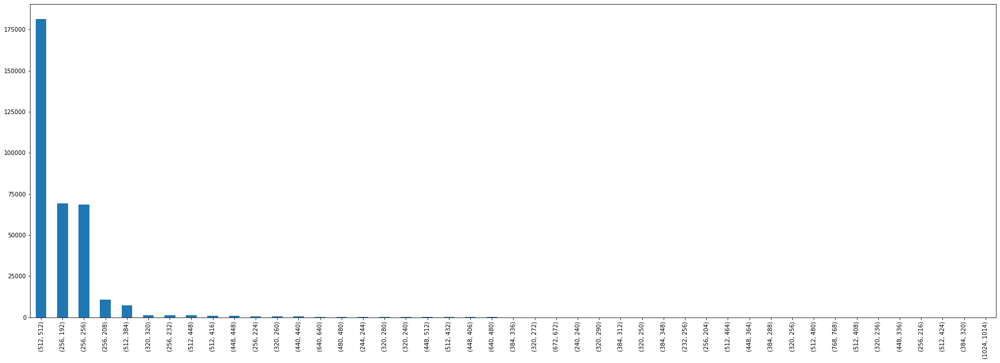

In [22]:
plt.figure(figsize=(30, 10))
df_2['img_size'].value_counts().plot(kind='bar')

<AxesSubplot:>

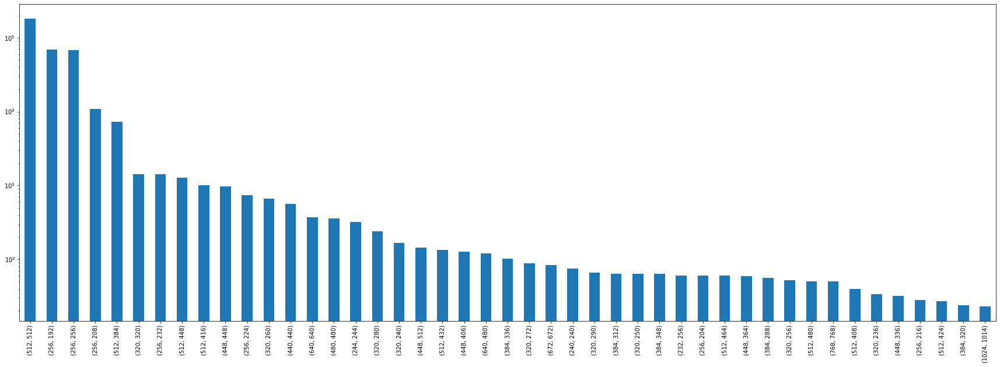

In [23]:
plt.figure(figsize=(30, 10))
df_2['img_size'].value_counts().plot(kind='bar', logy=True)

## pixel spacing 확인

In [24]:
# 'pixel_spacing'
df_2['pixel_spacing'].unique()

array([('0.5', '0.5'), ('1.0', '1.0'),
       ('0.468800008296967', '0.468800008296967'),
       ('0.507799983024597', '0.507799983024597'), ('0.46875', '0.46875'),
       ('0.9375', '0.9375'), ('0.9765625', '0.9765625'),
       ('0.449200004339218', '0.449200004339218'),
       ('0.4296875', '0.4296875'),
       ('0.446428567171097', '0.446428567171097'), ('0.3125', '0.3125'),
       ('0.375', '0.375'), ('0.976562023162842', '0.976562023162842'),
       ('0.75', '0.75'), ('0.6875', '0.6875'),
       ('0.513392865657806', '0.513392865657806'),
       ('1.015625', '1.015625'), ('0.48828125', '0.48828125'),
       ('0.539099991321564', '0.539099991321564'),
       ('0.488281011581421', '0.488281011581421'),
       ('0.42969998717308', '0.42969998717308'),
       ('0.976599991321564', '0.976599991321564'), ('0.78125', '0.78125'),
       ('0.71875', '0.71875'), ('0.572916686534882', '0.572916686534882'),
       ('0.44921875', '0.44921875'), ('0.4375', '0.4375'),
       ('1.01559996604919',

In [25]:
df_2['pixel_spacing'].value_counts()

(0.5, 0.5)                                163204
(0.9765625, 0.9765625)                     61175
(1, 1)                                     53430
(0.9375, 0.9375)                           22166
(0.48828125, 0.48828125)                    7765
                                           ...  
(0.449218988418579, 0.449218988418579)        24
(0.215025365352631, 0.215025365352631)        23
(0.585900008678436, 0.585900008678436)        23
(0.468751013278961, 0.4687480032444)          23
(0.4687480032444, 0.4687480032444)            20
Name: pixel_spacing, Length: 66, dtype: int64

<AxesSubplot:>

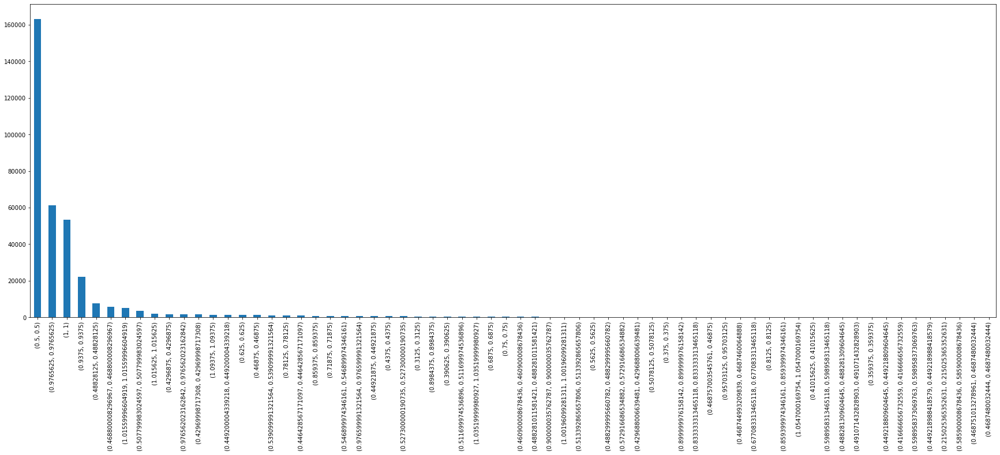

In [26]:
plt.figure(figsize=(30, 10))
df_2['pixel_spacing'].value_counts().plot(kind='bar')

<AxesSubplot:>

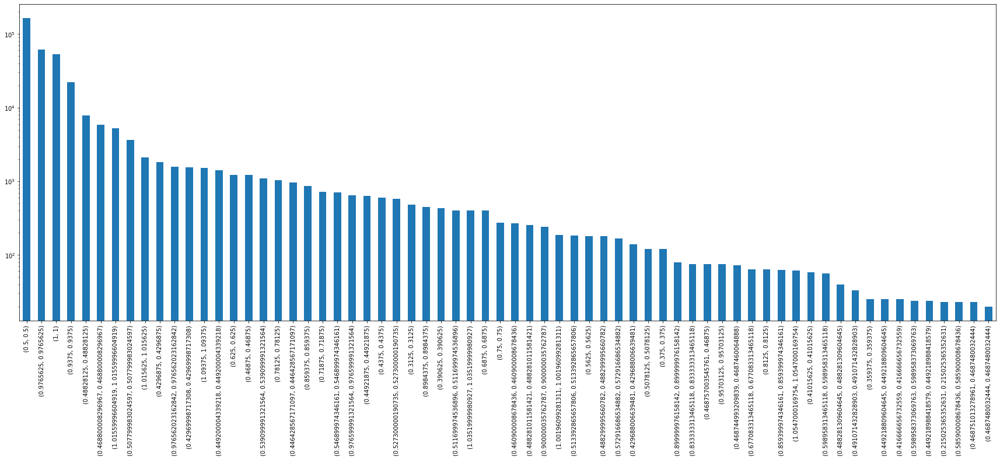

In [27]:
plt.figure(figsize=(30, 10))
df_2['pixel_spacing'].value_counts().plot(kind='bar', logy=True)

## image_orientation_patient 확인

In [28]:
df_2['image_orientation_patient'].unique()

array([('0.99877', '-0.02273', '0.04406', '0.04592', '0.08904', '-0.99497'),
       ('0.99913', '-0.02808', '0.03097', '0.02407', '0.99209', '0.12321'),
       ('0.02872', '0.99864', '0.04348', '0.01714', '0.043', '-0.99893'),
       ...,
       ('0.991487', '0.105603', '0.0761731', '-0.0806441', '0.957331', '-0.277514'),
       ('-0.090759', '0.930507', '-0.354852', '0.127458', '-0.342539', '-0.930818'),
       ('-0.0907591', '0.930507', '-0.354852', '0.127458', '-0.342539', '-0.930818')],
      dtype=object)

In [29]:
df_2['image_orientation_patient'].value_counts()

(0.9999984769134, -0.0017453283007, 0, 0.00174532830068, 0.9999984769134, 0)    73671
(1, -0, 0, -0, 1, 0)                                                            48557
(-0, 1, 0, -0, -0, -1)                                                          21579
(1, -0, 0, -0, -0, -1)                                                          15934
(1, -2.051034e-10, 0, 2.051034e-10, 1, 0)                                        6629
                                                                                ...  
(0.999961, -8.10008e-05, 0.008876, 0.00887635, 0.00908564, -0.999919)               1
(0.999961, -8.10027e-05, 0.00887597, 0.00887635, 0.00908564, -0.999919)             1
(0.998839, -0, -0.0481631, 0.0010318, 0.999771, 0.0213974)                          1
(0.999948, 0.00901508, 0.0047383, -0.00867319, 0.997661, -0.0678091)                1
(0.999994, -0.00339508, 0.000824783, 0.00339403, 0.999993, 0.00127458)              1
Name: image_orientation_patient, Length: 1749, dtype: 

<AxesSubplot:>

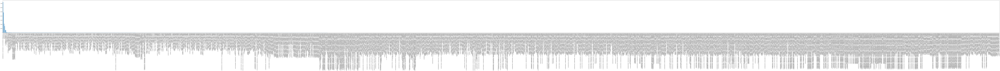

In [30]:
plt.figure(figsize=(300, 10))
df_2['image_orientation_patient'].value_counts().plot(kind='bar')

<AxesSubplot:>

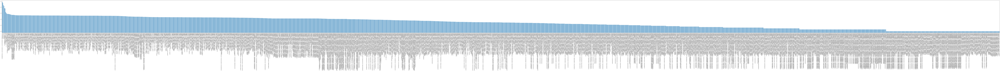

In [31]:
plt.figure(figsize=(300, 10))
df_2['image_orientation_patient'].value_counts().plot(kind='bar', logy=True)

# image_position_patient

In [32]:
df_2['image_position_patient'].unique()

array([('-135.21', '48.7923', '118.876'),
       ('-135.345', '41.6227', '118.228'),
       ('-138.71', '-137.616', '102.032'), ...,
       ('8.31278', '-154.688', '142.165'),
       ('5.34974', '-155.077', '141.903'),
       ('102.637', '-142.301', '150.523')], dtype=object)

In [33]:
df_2['image_position_patient'].value_counts()

(-120, -122.927, 67.8293)        5
(-120, -122.927, -7.17073)       5
(-120, -122.927, 37.8293)        5
(-120, -122.927, -46.1707)       5
(-120, -122.927, 7.82927)        5
                                ..
(-132.175, -162.141, -54.471)    1
(-122.269, -168.575, 93.8594)    1
(-122.828, -168.212, 85.4859)    1
(-120.791, -169.535, 115.989)    1
(102.637, -142.301, 150.523)     1
Name: image_position_patient, Length: 282480, dtype: int64

# photometric_interpretation 확인

In [36]:
df_2['photometric_interpretation'].unique()

array(['MONOCHROME2'], dtype=object)

In [37]:
df_2['photometric_interpretation'].value_counts()

MONOCHROME2    348641
Name: photometric_interpretation, dtype: int64

## magnetic_field_strength 확인

In [38]:
df_2['magnetic_field_strength'].unique()

array([ 3.00000000e+00,  1.50000000e+00, -1.00000000e+00,  1.50000000e+04,
        1.49400000e+00,  1.49399996e+00,  1.49380600e+00])

In [39]:
df_2['magnetic_field_strength'].value_counts()

 3.000000        323035
 1.500000         20951
 15000.000000      2577
-1.000000          1428
 1.493806           380
 1.494000           190
 1.494000            80
Name: magnetic_field_strength, dtype: int64

<AxesSubplot:>

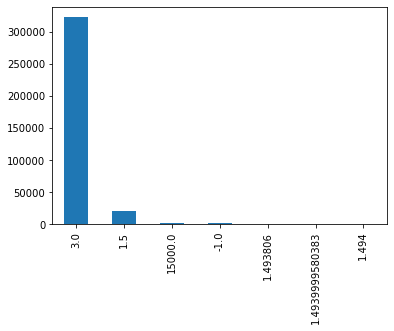

In [40]:
df_2['magnetic_field_strength'].value_counts().plot(kind='bar')

<AxesSubplot:>

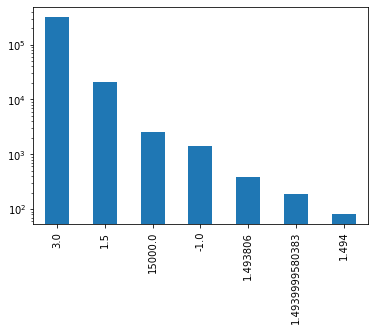

In [41]:
df_2['magnetic_field_strength'].value_counts().plot(kind='bar', logy=True)

In [35]:
# df_2[df_2['img_size'] != (512, 512)][['pid', 'img_size']]
df_2[df_2['img_size'] != (512, 512)].to_csv('./meta_file.csv')